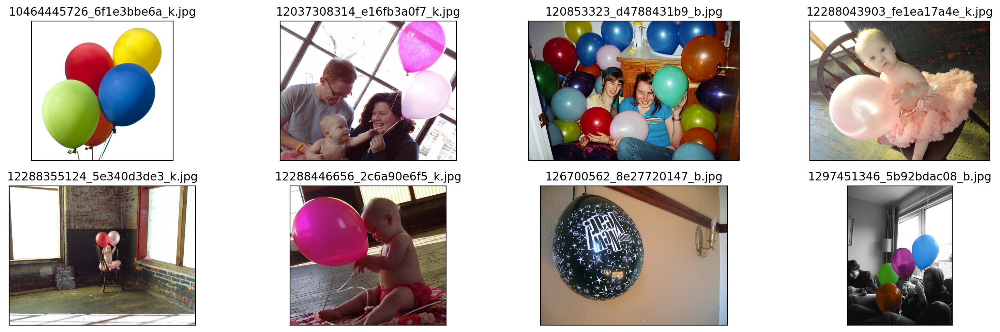

In [3]:
# 数据集可视化

import os
import matplotlib.pyplot as plt
from PIL import Image

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
base_path = '../balloon_dataset/balloon'

original_images = []
images = []
texts = []
plt.figure(figsize=(16, 5))

image_paths= [filename for filename in os.listdir(base_path+'/train')][:8]

for i,filename in enumerate(image_paths):
    name = os.path.splitext(filename)[0]

    image = Image.open(base_path+'/train/'+filename).convert("RGB")
  
    plt.subplot(2, 4, i+1)
    plt.imshow(image)
    plt.title(f"{filename}")
    plt.xticks([])
    plt.yticks([])

plt.tight_layout()

我们也提供了 coco json 标注，用户可以直接使用，而无需自己重新标注。COCO Json 可视化如下所示

In [8]:
# json2coco
import json
import re
import cv2
from collections import defaultdict
import os.path as osp

def json2coco(path, file):
    # 读取JSON文件
    with open(osp.join(path, 'via_region_data.json')) as f:
        annotations = json.load(f)

    # 初始化COCO格式字典
    coco_dict = defaultdict(list)
    coco_dict['info'] = {}
    coco_dict['licenses'] = []
    coco_dict['categories'] = []
    coco_dict['images'] = []
    coco_dict['annotations'] = []

    # 添加info信息
    coco_dict['info']['version'] = '1.0'
    coco_dict['info']['description'] = 'Balloon Dataset'
    coco_dict['info']['year'] = 2023
    coco_dict['info']['contributor'] = 'YUJUNYU'
    coco_dict['info']['date_created'] = '2023-06-13'

    # 添加categories信息
    category_id = 1
    category = {'id': category_id, 'name': 'balloon', 'supercategory': 'object'}
    coco_dict['categories'].append(category)

    # 遍历每个图像的注释信息
    annotation_id = 1
    for image_id, image_info in annotations.items():
        # 从image_id中提取出正确的图像ID
        match = re.search(r'(\d+)_.*', image_id)
        if match:
            image_id = match.group(1)
        else:
            continue
        
        # 获取图像的文件名和大小
        filename = image_info['filename']
        size = image_info['size']
        # 获取图像的height和width
        img = cv2.imread(os.path.join(path, filename))
        height, width, _ = img.shape
        # print(filename,height,width)
        
        # 添加图像信息
        image = {'id': int(image_id), 'file_name': filename, 'width': width, 'height': height}
        coco_dict['images'].append(image)
        
        # 获取多边形注释信息
        regions = image_info['regions']
        for region_id, region_info in regions.items():
            # 获取多边形顶点坐标
            x = region_info['shape_attributes']['all_points_x']
            y = region_info['shape_attributes']['all_points_y']
            points = list(zip(x, y))
            
            # 计算多边形的边界框
            xmin = min(x)
            xmax = max(x)
            ymin = min(y)
            ymax = max(y)
            width = xmax - xmin
            height = ymax - ymin
            
            # 添加注释信息
            annotation = {'id': annotation_id, 'image_id': int(image_id), 'category_id': category_id, 'segmentation': [points], 'area': width * height, 'bbox': [xmin, ymin, width, height], 'iscrowd': 0}
            coco_dict['annotations'].append(annotation)
            annotation_id += 1

    # 保存COCO格式文件
    with open(osp.join(path, file), 'w') as f:
        json.dump(coco_dict, f)

    print('success！')

# 训练路径
train_path = base_path + '/train'
train_file = 'balloon_train.json'
json2coco(train_path, train_file)

# 验证路径
val_path = base_path+'/val'
val_file = 'balloon_val.json'
json2coco(val_path, val_file)

success！
success！


loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


C:\Users\giser\AppData\Local\Temp\ipykernel_32072\3082764585.py:23: DeprecationWarning: FLIP_LEFT_RIGHT is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.FLIP_LEFT_RIGHT instead.
  2: Image.FLIP_LEFT_RIGHT,
C:\Users\giser\AppData\Local\Temp\ipykernel_32072\3082764585.py:24: DeprecationWarning: ROTATE_180 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_180 instead.
  3: Image.ROTATE_180,
C:\Users\giser\AppData\Local\Temp\ipykernel_32072\3082764585.py:25: DeprecationWarning: FLIP_TOP_BOTTOM is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.FLIP_TOP_BOTTOM instead.
  4: Image.FLIP_TOP_BOTTOM,
C:\Users\giser\AppData\Local\Temp\ipykernel_32072\3082764585.py:26: DeprecationWarning: TRANSPOSE is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.TRANSPOSE instead.
  5: Image.TRANSPOSE,
C:\Users\giser\AppData\Local\Temp\ipykernel_32072\3082764585.py:27: DeprecationWarning: ROTATE_270 is dep

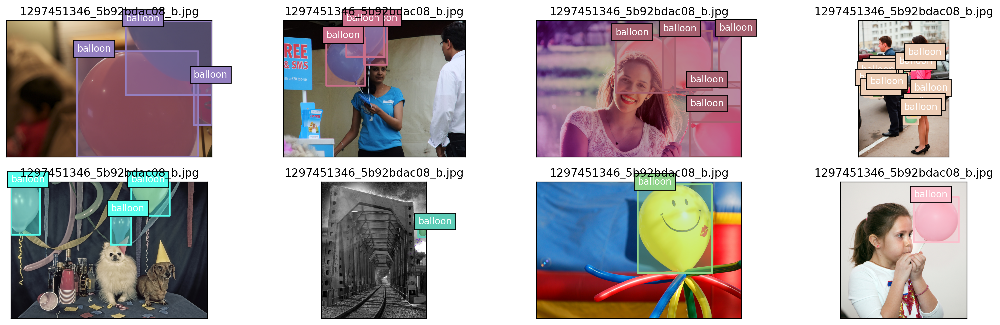

In [4]:
from pycocotools.coco import COCO
import numpy as np
import os.path as osp
from matplotlib.collections import PatchCollection
from matplotlib.patches import Polygon

def apply_exif_orientation(image):
    _EXIF_ORIENT = 274
    if not hasattr(image, 'getexif'):
        return image

    try:
        exif = image.getexif()
    except Exception:
        exif = None

    if exif is None:
        return image

    orientation = exif.get(_EXIF_ORIENT)

    method = {
        2: Image.FLIP_LEFT_RIGHT,
        3: Image.ROTATE_180,
        4: Image.FLIP_TOP_BOTTOM,
        5: Image.TRANSPOSE,
        6: Image.ROTATE_270,
        7: Image.TRANSVERSE,
        8: Image.ROTATE_90,
    }.get(orientation)
    if method is not None:
        return image.transpose(method)
    return image


def show_bbox_only(coco, anns, show_label_bbox=True, is_filling=True):
    """Show bounding box of annotations Only."""
    if len(anns) == 0:
        return

    ax = plt.gca()
    ax.set_autoscale_on(False)

    image2color = dict()
    for cat in coco.getCatIds():
        image2color[cat] = (np.random.random((1, 3)) * 0.7 + 0.3).tolist()[0]

    polygons = []
    colors = []

    for ann in anns:
        color = image2color[ann['category_id']]
        bbox_x, bbox_y, bbox_w, bbox_h = ann['bbox']
        poly = [[bbox_x, bbox_y], [bbox_x, bbox_y + bbox_h],
                [bbox_x + bbox_w, bbox_y + bbox_h], [bbox_x + bbox_w, bbox_y]]
        polygons.append(Polygon(np.array(poly).reshape((4, 2))))
        colors.append(color)

        if show_label_bbox:
            label_bbox = dict(facecolor=color)
        else:
            label_bbox = None

        ax.text(
            bbox_x,
            bbox_y,
            '%s' % (coco.loadCats(ann['category_id'])[0]['name']),
            color='white',
            bbox=label_bbox)

    if is_filling:
        p = PatchCollection(
            polygons, facecolor=colors, linewidths=0, alpha=0.4)
        ax.add_collection(p)
    p = PatchCollection(
        polygons, facecolor='none', edgecolors=colors, linewidths=2)
    ax.add_collection(p)

coco = COCO(base_path+'/train/balloon_train.json')
image_ids = coco.getImgIds()
np.random.shuffle(image_ids)

plt.figure(figsize=(16, 5))


# 只可视化 8 张图片
for i in range(8):
    image_data = coco.loadImgs(image_ids[i])[0]
    image_path = osp.join(base_path+'/train',image_data['file_name'])
    annotation_ids = coco.getAnnIds(
            imgIds=image_data['id'], catIds=[], iscrowd=0)
    annotations = coco.loadAnns(annotation_ids)
    
    ax = plt.subplot(2, 4, i+1)
    image = Image.open(image_path).convert("RGB")
    
    # 这行代码很关键，否则可能图片和标签对不上
    image=apply_exif_orientation(image)
    
    ax.imshow(image)
    
    show_bbox_only(coco, annotations)
    
    plt.title(f"{filename}")
    plt.xticks([])
    plt.yticks([])
        
plt.tight_layout()    

In [7]:
# 当前路径位于 mmdetection/tutorials, 配置将写到 mmdetection/tutorials 路径下

config_cat = """
_base_ = '../MMDetection/mmdetection/configs/rtmdet/rtmdet_tiny_8xb32-300e_coco.py'

data_root = '../balloon_dataset/balloon/'

metainfo = {
    'classes': ('balloon',),
    'palette': [
        (220, 20, 60),
    ]
}
num_classes = 1

max_epochs = 40
train_batch_size_per_gpu = 12
train_num_workers = 4

val_batch_size_per_gpu = 1
val_num_workers = 2

num_epochs_stage2 = 5

base_lr = 12 * 0.004 / (32*8)
load_from = 'https://download.openmmlab.com/mmdetection/v3.0/rtmdet/rtmdet_tiny_8xb32-300e_coco/rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth'  # noqa

model = dict(
    backbone=dict(frozen_stages=4),
    bbox_head=dict(dict(num_classes=num_classes)))

train_dataloader = dict(
    batch_size=train_batch_size_per_gpu,
    num_workers=train_num_workers,
    pin_memory=False,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        ann_file='train/balloon_train.json',
        data_prefix=dict(img='train/')))

val_dataloader = dict(
    batch_size=val_batch_size_per_gpu,
    num_workers=val_num_workers,
    dataset=dict(
        metainfo=metainfo,
        data_root=data_root,
        ann_file='val/balloon_val.json',
        data_prefix=dict(img='val/')))

test_dataloader = val_dataloader


param_scheduler = [
    dict(
        type='LinearLR',
        start_factor=1.0e-5,
        by_epoch=False,
        begin=0,
        end=30),
    dict(
        type='CosineAnnealingLR',
        eta_min=base_lr * 0.05,
        begin=max_epochs // 2,  
        end=max_epochs,
        T_max=max_epochs // 2,
        by_epoch=True,
        convert_to_iter_based=True),
]
optim_wrapper = dict(optimizer=dict(lr=base_lr))


_base_.custom_hooks[1].switch_epoch = max_epochs - num_epochs_stage2

val_evaluator = dict(ann_file=data_root + 'val/balloon_val.json')
test_evaluator = val_evaluator


default_hooks = dict(
    checkpoint=dict(interval=10, max_keep_ckpts=2, save_best='auto'),
    logger=dict(type='LoggerHook', interval=5))
train_cfg = dict(max_epochs=max_epochs, val_interval=10)
"""

with open('rtmdet_tiny_1xb12-40e_cat.py', 'w', encoding='gbk') as f:
    f.write(config_cat)

需要注意几个问题：

1. 自定义数据集中最重要的是 metainfo 字段，用户在配置完成后要记得将其传给 dataset，否则不生效(有些用户在自定义数据集时候喜欢去 直接修改 coco.py 源码，这个是强烈不推荐的做法，正确做法是配置 metainfo 并传给 dataset)

2. 如果用户 metainfo 配置不正确，通常会出现几种情况：(1) 出现 num_classes 不匹配错误 (2) loss_bbox 始终为 0 (3) 出现训练后评估结果为空等典型情况

3. MMDetection 提供的学习率大部分都是基于 8 卡，如果你的总 bs 不同，一定要记得缩放学习率，否则有些算法很容易出现 NAN，具体参考 https://mmdetection.readthedocs.io/zh_CN/latest/user_guides/train.html#id3

# 3 训练前可视化验证

我们可以采用 mmdet 提供的 `tools/analysis_tools/browse_dataset.py` 脚本来对训练前的 dataloader 输出进行可视化，确保数据部分没有问题。
考虑到我们仅仅想可视化前几张图片，因此下面基于 browse_dataset.py 实现一个简单版本即可

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
06/13 14:16:12 - mmengine - WARNING - `Visualizer` backend is not initialized because save_dir is None.


d:\miniconda\envs\openmmlab\lib\site-packages\mmengine\visualization\visualizer.py:757: UserWarning: Warning: The bbox is out of bounds, the drawn bbox may not be in the image
  warnings.warn(
d:\miniconda\envs\openmmlab\lib\site-packages\mmengine\visualization\visualizer.py:828: UserWarning: Warning: The polygon is out of bounds, the drawn polygon may not be in the image
  warnings.warn(


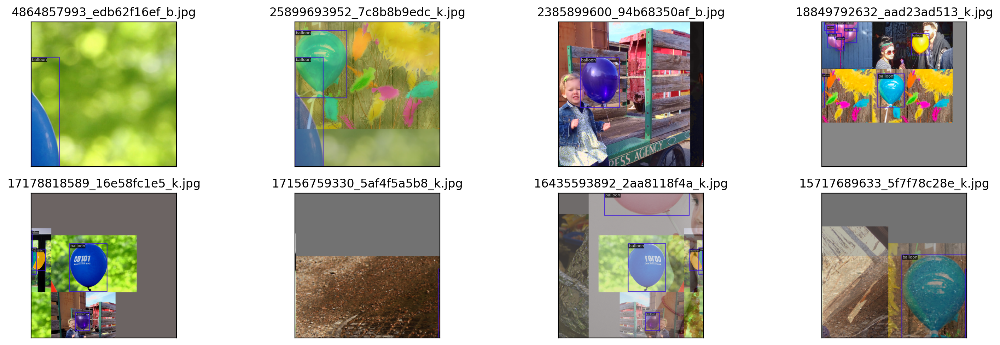

In [8]:
from mmdet.registry import DATASETS, VISUALIZERS
from mmengine.config import Config
from mmengine.registry import init_default_scope

cfg = Config.fromfile('rtmdet_tiny_1xb12-40e_cat.py')

init_default_scope(cfg.get('default_scope', 'mmdet'))

dataset = DATASETS.build(cfg.train_dataloader.dataset)
visualizer = VISUALIZERS.build(cfg.visualizer)
visualizer.dataset_meta = dataset.metainfo

plt.figure(figsize=(16, 5))

# 只可视化前 8 张图片
for i in range(8):
   item=dataset[i]

   img = item['inputs'].permute(1, 2, 0).numpy()
   data_sample = item['data_samples'].numpy()
   gt_instances = data_sample.gt_instances
   img_path = osp.basename(item['data_samples'].img_path)

   gt_bboxes = gt_instances.get('bboxes', None)
   gt_instances.bboxes = gt_bboxes.tensor
   data_sample.gt_instances = gt_instances

   visualizer.add_datasample(
            osp.basename(img_path),
            img,
            data_sample,
            draw_pred=False,
            show=False)
   drawed_image=visualizer.get_image()

   plt.subplot(2, 4, i+1)
   plt.imshow(drawed_image[..., [2, 1, 0]])
   plt.title(f"{osp.basename(img_path)}")
   plt.xticks([])
   plt.yticks([])

plt.tight_layout()   

# 4 模型训练

在验证数据流本身没有问题后，就可以开始进行训练了

In [9]:
!python ../MMDetection/mmdetection/tools/train.py rtmdet_tiny_1xb12-40e_cat.py

06/13 14:16:31 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: win32
    Python: 3.8.16 (default, Mar  2 2023, 03:18:16) [MSC v.1916 64 bit (AMD64)]
    CUDA available: True
    numpy_random_seed: 1726284423
    GPU 0: NVIDIA GeForce RTX 3050
    CUDA_HOME: C:/Program Files/NVIDIA GPU Computing Toolkit/CUDA\v11.7
    NVCC: Not Available
    MSVC: 用于 x64 的 Microsoft (R) C/C++ 优化编译器 19.16.27049 版
    GCC: n/a
    PyTorch: 2.0.1+cu118
    PyTorch compiling details: PyTorch built with:
  - C++ Version: 199711
  - MSVC 193431937
  - Intel(R) Math Kernel Library Version 2020.0.2 Product Build 20200624 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v2.7.3 (Git Hash 6dbeffbae1f23cbbeae17adb7b5b13f1f37c080e)
  - OpenMP 2019
  - LAPACK is enabled (usually provided by MKL)
  - CPU capability usage: AVX2
  - CUDA Runtime 11.8
  - NVCC architecture flags: -gencode;arch=compute_37,code=sm_37;-gencode;arch=compute

ϵͳ�Ҳ���ָ����·����
d:\miniconda\envs\openmmlab\lib\site-packages\torch\functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:3484.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


由于 google colab 的 IO 读取 data_time 时间很长，训练大概需要 15 分钟。实际上在低端 1660 显卡的本地环境上运行大概只需要 5 分钟。

运行完成后，会在当前路径下生成 work_dirs/rtmdet_tiny_1xb12-40e_cat 路径，内部存放了 log 和权重文件。

可以发现最佳性能为第 30 epoch 时候，性能为 85.2 mAP (注： 由于训练 epoch 很短，因此多次运行可能 mAP 会有 3~4 个点的差异)。

```text
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.986
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.922
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.852
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.920
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.920
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.920
```

# 5 模型测试和推理
如果你想离线测试，则可以使用我们提供的 test.py 脚本

In [10]:
!python ../MMDetection/mmdetection/tools/test.py rtmdet_tiny_1xb12-40e_cat.py work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco_bbox_mAP_epoch_40.pth

06/13 14:23:42 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: win32
    Python: 3.8.16 (default, Mar  2 2023, 03:18:16) [MSC v.1916 64 bit (AMD64)]
    CUDA available: True
    numpy_random_seed: 1907679933
    GPU 0: NVIDIA GeForce RTX 3050
    CUDA_HOME: C:/Program Files/NVIDIA GPU Computing Toolkit/CUDA\v11.7
    NVCC: Not Available
    MSVC: 用于 x64 的 Microsoft (R) C/C++ 优化编译器 19.16.27049 版
    GCC: n/a
    PyTorch: 2.0.1+cu118
    PyTorch compiling details: PyTorch built with:
  - C++ Version: 199711
  - MSVC 193431937
  - Intel(R) Math Kernel Library Version 2020.0.2 Product Build 20200624 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v2.7.3 (Git Hash 6dbeffbae1f23cbbeae17adb7b5b13f1f37c080e)
  - OpenMP 2019
  - LAPACK is enabled (usually provided by MKL)
  - CPU capability usage: AVX2
  - CUDA Runtime 11.8
  - NVCC architecture flags: -gencode;arch=compute_37,code=sm_37;-gencode;arch=compute

ϵͳ�Ҳ���ָ����·����
d:\miniconda\envs\openmmlab\lib\site-packages\torch\functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:3484.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


在测试阶段，你可以设置 --show-dir 将测试图片的真实值和预测值保存下来，然后进行深入分析。

In [11]:
!python ../MMDetection/mmdetection/tools/test.py rtmdet_tiny_1xb12-40e_cat.py work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco_bbox_mAP_epoch_40.pth --show-dir results

06/13 14:25:10 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: win32
    Python: 3.8.16 (default, Mar  2 2023, 03:18:16) [MSC v.1916 64 bit (AMD64)]
    CUDA available: True
    numpy_random_seed: 1174075639
    GPU 0: NVIDIA GeForce RTX 3050
    CUDA_HOME: C:/Program Files/NVIDIA GPU Computing Toolkit/CUDA\v11.7
    NVCC: Not Available
    MSVC: 用于 x64 的 Microsoft (R) C/C++ 优化编译器 19.16.27049 版
    GCC: n/a
    PyTorch: 2.0.1+cu118
    PyTorch compiling details: PyTorch built with:
  - C++ Version: 199711
  - MSVC 193431937
  - Intel(R) Math Kernel Library Version 2020.0.2 Product Build 20200624 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v2.7.3 (Git Hash 6dbeffbae1f23cbbeae17adb7b5b13f1f37c080e)
  - OpenMP 2019
  - LAPACK is enabled (usually provided by MKL)
  - CPU capability usage: AVX2
  - CUDA Runtime 11.8
  - NVCC architecture flags: -gencode;arch=compute_37,code=sm_37;-gencode;arch=compute

ϵͳ�Ҳ���ָ����·����
d:\miniconda\envs\openmmlab\lib\site-packages\torch\functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:3484.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
d:\miniconda\envs\openmmlab\lib\site-packages\mmengine\visualization\visualizer.py:757: UserWarning: Warning: The bbox is out of bounds, the drawn bbox may not be in the image
  warnings.warn(
d:\miniconda\envs\openmmlab\lib\site-packages\mmengine\visualization\visualizer.py:828: UserWarning: Warning: The polygon is out of bounds, the drawn polygon may not be in the image
  warnings.warn(
d:\miniconda\envs\openmmlab\lib\site-packages\mmengine\visualization\visualizer.py:505: UserWarning: Warning: The text is out of bounds, the drawn text may not be in the image
  warnings.warn(


会在 `work_dir/rtmdet_tiny_1xb12-40e_cat/当前时间戳/results/` 下生成测试图片，下面对前 8 张图片进行可视化

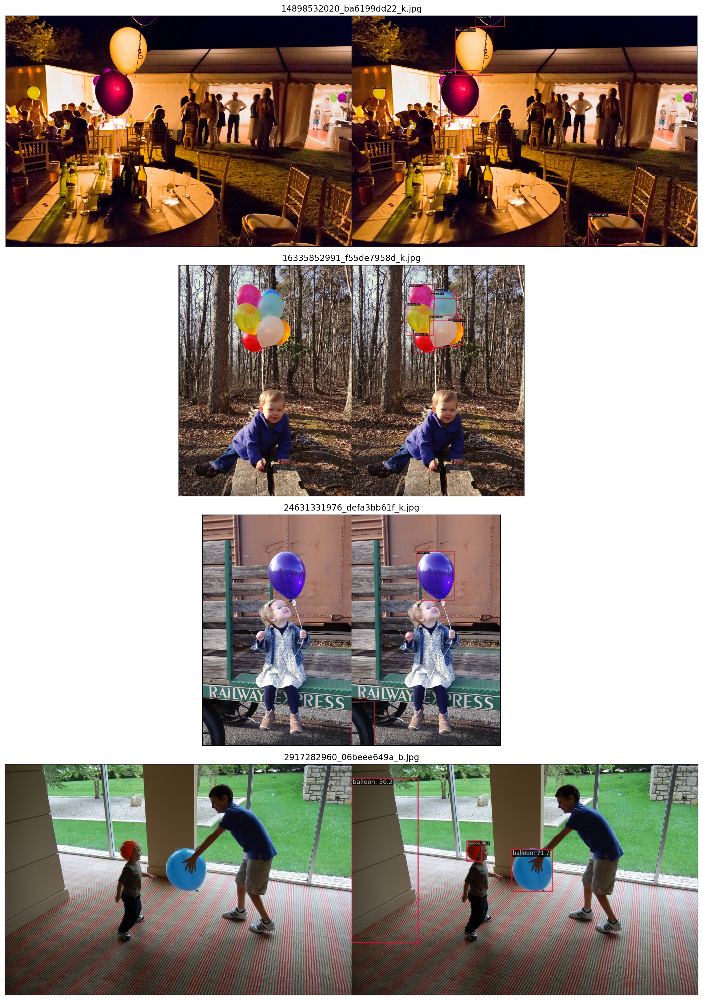

In [12]:
# 数据集可视化

import os
import matplotlib.pyplot as plt
from PIL import Image

%matplotlib inline

plt.figure(figsize=(20, 20))

# 你如果重新跑，这个时间戳是不一样的，需要自己修改
root_path='work_dirs/rtmdet_tiny_1xb12-40e_cat/20230613_142457/results/'
image_paths= [filename for filename in os.listdir(root_path)][:4]

for i,filename in enumerate(image_paths):
    name = os.path.splitext(filename)[0]

    image = Image.open(root_path+filename).convert("RGB")
  
    plt.subplot(4, 1, i+1)
    plt.imshow(image)
    plt.title(f"{filename}")
    plt.xticks([])
    plt.yticks([])

plt.tight_layout()

左边显示的是标注框，右边显示的是预测框。

实际上 MMDetection 支持多种可视化后端，例如 TensorBoard 和 WandB，默认情况下是将图片保存到本地，用户只需要修改可视化部分配置即可轻松切换。如下所示

以下配置只需要加到 `rtmdet_tiny_1xb12-40e_cat.py` 配置最后即可

**(1) 同时使用本地和 WandB 后端**

```python
visualizer = dict(vis_backends = [dict(type='LocalVisBackend'), dict(type='WandbVisBackend')])
```

**(2) 仅仅使用 TensorBoard 后端**

```python
visualizer = dict(vis_backends = [dict(type='TensorboardVisBackend')])
```
修改配置后重新运行 test.py 即可在 WandB 和 TensorBoard 前端界面查看 图片和 log 等。

如果想对单张图片进行推理，你可以直接使用 `mmdetection/demo/image_demo.py` 脚本

In [14]:
!python ../MMDetection/mmdetection/demo/image_demo.py ./balloon.jpg rtmdet_tiny_1xb12-40e_cat.py --weights work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco_bbox_mAP_epoch_40.pth

Loads checkpoint by local backend from path: work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco_bbox_mAP_epoch_40.pth
06/13 16:14:45 - mmengine - WARNING - Failed to search registry with scope "mmdet" in the "function" registry tree. As a workaround, the current "function" registry in "mmengine" is used to build instance. This may cause unexpected failure when running the built modules. Please check whether "mmdet" is a correct scope, or whether the registry is initialized.
06/13 16:14:46 - mmengine - WARNING - `Visualizer` backend is not initialized because save_dir is None.

Inference ----------------------------------------   
Inference ----------------------------------------   
Inference ----------------------------------------   
Inference ----------------------------------------   
Inference ----------------------------------------   
Inference ----------------------------------------   
Inference ----------------------------------------   
Inference ---------------------------------

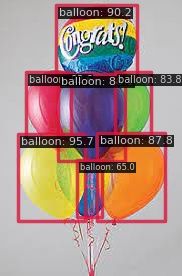

In [15]:
Image.open('outputs/vis/balloon.jpg')

# 6 可视化分析

可视化分析包括特征图可视化以及类似 Grad CAM 等可视化分析手段。不过由于 MMDetection 中还没有实现，我们可以直接采用 MMYOLO 中提供的功能和脚本。MMYOLO 是基于 MMDetection 开发，并且此案有了统一的代码组织形式，因此 MMDetection 配置可以直接在 MMYOLO 中使用，无需更改配置。

## 特征图可视化

MMYOLO 中，将使用 MMEngine 提供的 `Visualizer` 可视化器进行特征图可视化，其具备如下功能：

- 支持基础绘图接口以及特征图可视化。
- 支持选择模型中的不同层来得到特征图，包含 `squeeze_mean` ， `select_max` ， `topk` 三种显示方式，用户还可以使用 `arrangement` 自定义特征图显示的布局方式。

你可以调用 `demo/featmap_vis_demo.py` 来简单快捷地得到可视化结果，为了方便理解，将其主要参数的功能梳理如下：

- `img`：选择要用于特征图可视化的图片，支持单张图片或者图片路径列表。

- `config`：选择算法的配置文件。

- `checkpoint`：选择对应算法的权重文件。

- `--out-file`：将得到的特征图保存到本地，并指定路径和文件名。

- `--device`：指定用于推理图片的硬件，`--device cuda：0`  表示使用第 1 张 GPU 推理，`--device cpu` 表示用 CPU 推理。

- `--score-thr`：设置检测框的置信度阈值，只有置信度高于这个值的框才会显示。

- `--preview-model`：可以预览模型，方便用户理解模型的特征层结构。

- `--target-layers`：对指定层获取可视化的特征图。

  - 可以单独输出某个层的特征图，例如： `--target-layers backbone` ,  `--target-layers neck` ,  `--target-layers backbone.stage4` 等。
  - 参数为列表时，也可以同时输出多个层的特征图，例如： `--target-layers backbone.stage4 neck` 表示同时输出 backbone 的 stage4 层和 neck 的三层一共四层特征图。

- `--channel-reduction`：输入的 Tensor 一般是包括多个通道的，`channel_reduction` 参数可以将多个通道压缩为单通道，然后和图片进行叠加显示，有以下三个参数可以设置：

  - `squeeze_mean`：将输入的 C 维度采用 mean 函数压缩为一个通道，输出维度变成 (1, H, W)。
  - `select_max`：将输入先在空间维度 sum，维度变成 (C, )，然后选择值最大的通道。
  - `None`：表示不需要压缩，此时可以通过 `topk` 参数可选择激活度最高的 `topk` 个特征图显示。

- `--topk`：只有在 `channel_reduction` 参数为 `None` 的情况下， `topk` 参数才会生效，其会按照激活度排序选择 `topk` 个通道，然后和图片进行叠加显示，并且此时会通过 `--arrangement` 参数指定显示的布局，该参数表示为一个数组，两个数字需要以空格分开，例如： `--topk 5 --arrangement 2 3` 表示以 `2行 3列` 显示激活度排序最高的 5 张特征图， `--topk 7 --arrangement 3 3` 表示以 `3行 3列` 显示激活度排序最高的 7 张特征图。

  - 如果 topk 不是 -1，则会按照激活度排序选择 topk 个通道显示。
  - 如果 topk = -1，此时通道 C 必须是 1 或者 3 表示输入数据是图片，否则报错提示用户应该设置 `channel_reduction` 来压缩通道。

- 考虑到输入的特征图通常非常小，函数默认将特征图进行上采样后方便进行可视化。

**注意：当图片和特征图尺度不一样时候，`draw_featmap` 函数会自动进行上采样对齐。如果你的图片在推理过程中前处理存在类似 Pad 的操作此时得到的特征图也是 Pad 过的，那么直接上采样就可能会出现不对齐问题。**


我们计划采用 cat_dataset/images/IMG_20211024_223313.jpg 图片进行后续可视化分析，不过由于这张图片分辨率过大，会导致程序奔溃，因此我们先将其缩放处理

In [14]:
import cv2

img = cv2.imread('./balloon.jpg')
h,w=img.shape[:2]
resized_img = cv2.resize(img, (640, 640))
cv2.imwrite('resized_image.jpg', resized_img)

True

**1. 可视化 backbone 输出的 3 个通道**

Loads checkpoint by local backend from path: work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco_bbox_mAP_epoch_40.pth
06/14 16:05:45 - mmengine - WARNING - `Visualizer` backend is not initialized because save_dir is None.
[                                                  ] 0/1, elapsed: 0s, ETA:
[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1/1, 0.0 task/s, elapsed: 23s, ETA:     0sAll done!
Results have been saved at f:\C_TRANSFER\AI\AI_demo\DL\openmmlab\OpenMMlab_task3\提交文件\output


d:\miniconda\envs\openmmlab\lib\site-packages\torch\functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:3484.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
d:\miniconda\envs\openmmlab\lib\site-packages\mmengine\visualization\visualizer.py:757: UserWarning: Warning: The bbox is out of bounds, the drawn bbox may not be in the image
  warnings.warn(
d:\miniconda\envs\openmmlab\lib\site-packages\mmengine\visualization\visualizer.py:828: UserWarning: Warning: The polygon is out of bounds, the drawn polygon may not be in the image
  warnings.warn(
d:\miniconda\envs\openmmlab\lib\site-packages\mmengine\visualization\visualizer.py:984: UserWarning: Since the spatial dimensions of overlaid_image: (640, 640) and featmap: torch.Size([80, 80]) are not same, the feature map will 

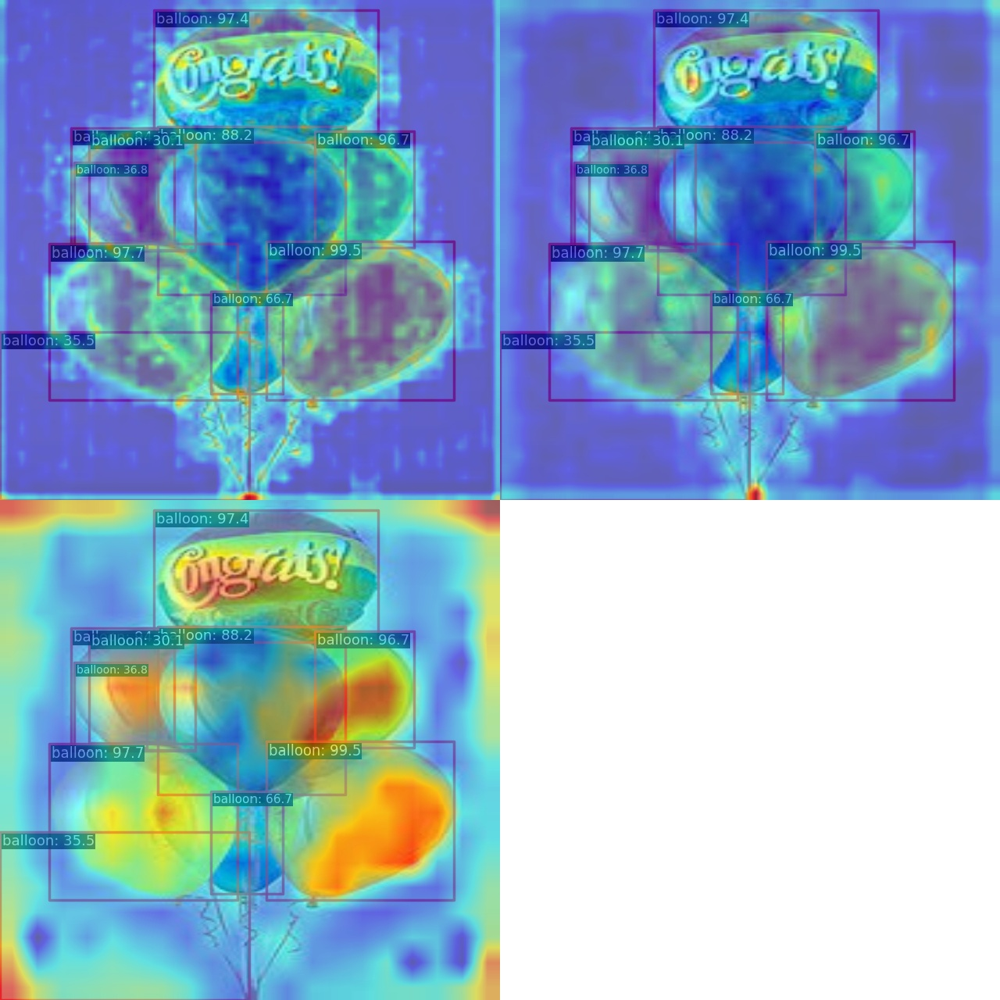

In [15]:
from PIL import Image
!python ../mmyolo/demo/featmap_vis_demo.py \
      resized_image.jpg \
      rtmdet_tiny_1xb12-40e_cat.py \
      work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco_bbox_mAP_epoch_40.pth  \
      --target-layers backbone  \
      --channel-reduction squeeze_mean
Image.open('output/resized_image.jpg')     

上图中绘制的 3 个输出特征图对应大中小输出特征图。由于本次训练的 backbone 实际上没有参与训练，从上图可以看到，大物体 cat 是在小特征图进行预测，这符合目标检测分层检测思想。

**2. 可视化 neck 输出的 3 个通道**

Traceback (most recent call last):
  File "../mmyolo/demo/featmap_vis_demo.py", line 199, in <module>
    main()
  File "../mmyolo/demo/featmap_vis_demo.py", line 110, in main
    model = init_detector(args.config, args.checkpoint, device=args.device)
  File "f:\c_transfer\ai\ai_demo\dl\openmmlab\openmmlab_task3\mmdetection\mmdetection\mmdet\apis\inference.py", line 68, in init_detector
    checkpoint = load_checkpoint(model, checkpoint, map_location='cpu')
  File "d:\miniconda\envs\openmmlab\lib\site-packages\mmengine\runner\checkpoint.py", line 636, in load_checkpoint
    checkpoint = _load_checkpoint(filename, map_location, logger)
  File "d:\miniconda\envs\openmmlab\lib\site-packages\mmengine\runner\checkpoint.py", line 548, in _load_checkpoint
    return CheckpointLoader.load_checkpoint(filename, map_location, logger)
  File "d:\miniconda\envs\openmmlab\lib\site-packages\mmengine\runner\checkpoint.py", line 330, in load_checkpoint
    return checkpoint_loader(filename, map_locatio

Loads checkpoint by local backend from path: work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco/bbox_mAP_epoch_30.pth


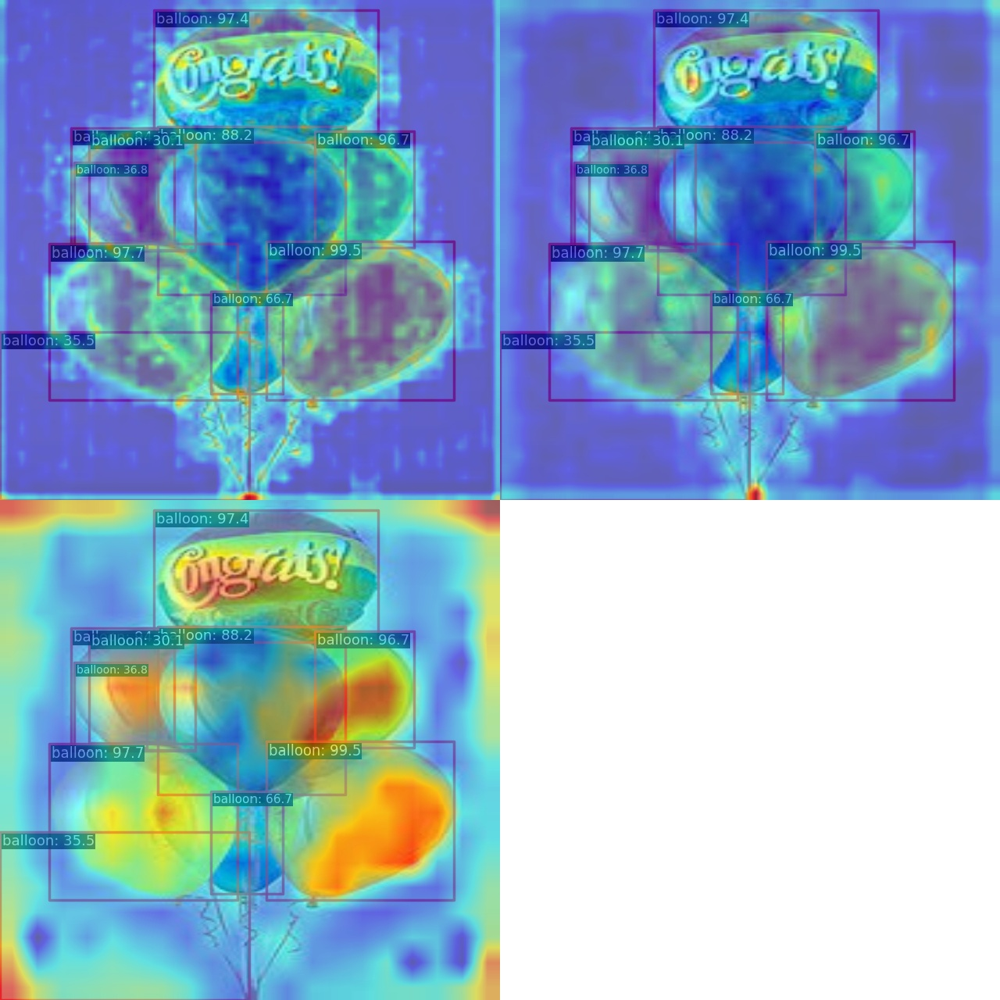

In [16]:
!python ../mmyolo/demo/featmap_vis_demo.py \
      resized_image.jpg \
      rtmdet_tiny_1xb12-40e_cat.py \
      work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco/bbox_mAP_epoch_30.pth  \
      --target-layers neck  \
      --channel-reduction squeeze_mean
Image.open('output/resized_image.jpg') 

从上图可以看出，由于 neck 是参与训练的，并且 FPN 间的信息融合导致输出特征图更加聚集

## Grad-Based CAM 可视化

由于目标检测的特殊性，这里实际上可视化的并不是 CAM 而是 Grad Box AM。使用前需要先安装 grad-cam 库


**(a) 查看 neck 输出的最小输出特征图的 Grad CAM**

d:\miniconda\envs\openmmlab\lib\site-packages\torch\functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:3484.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


The algorithm currently used is rtmdet
Loads checkpoint by local backend from path: work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco_bbox_mAP_epoch_40.pth
[                                                  ] 0/1, elapsed: 0s, ETA:
[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1/1, 0.2 task/s, elapsed: 7s, ETA:     0sAll done!
Results have been saved at f:\C_TRANSFER\AI\AI_demo\DL\openmmlab\OpenMMlab_task3\提交文件\output


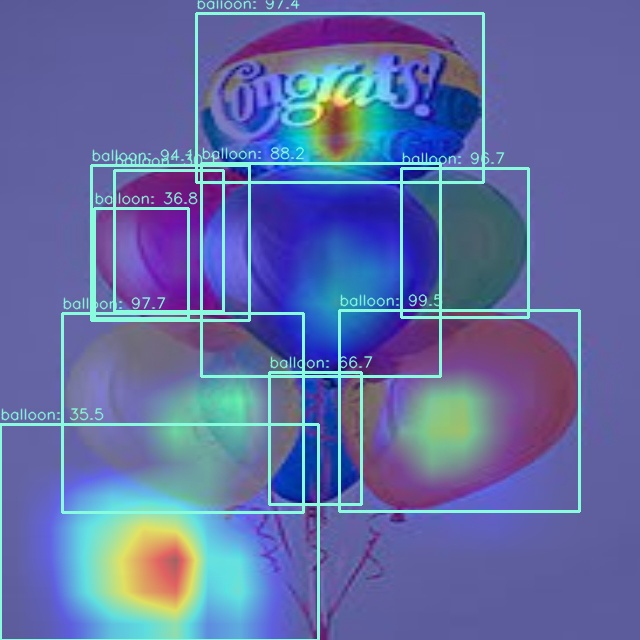

In [17]:
!python ../mmyolo/demo/boxam_vis_demo.py \
      resized_image.jpg \
      rtmdet_tiny_1xb12-40e_cat.py \
      work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco_bbox_mAP_epoch_40.pth  \
      --target-layer neck.out_convs[2]
Image.open('output/resized_image.jpg') 

可以看出效果较好

**(b) 查看 neck 输出的最大输出特征图的 Grad CAM**

The algorithm currently used is rtmdet
Loads checkpoint by local backend from path: work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco_bbox_mAP_epoch_40.pth
[                                                  ] 0/1, elapsed: 0s, ETA:
[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1/1, 0.3 task/s, elapsed: 4s, ETA:     0sAll done!
Results have been saved at f:\C_TRANSFER\AI\AI_demo\DL\openmmlab\OpenMMlab_task3\提交文件\output


d:\miniconda\envs\openmmlab\lib\site-packages\torch\functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:3484.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


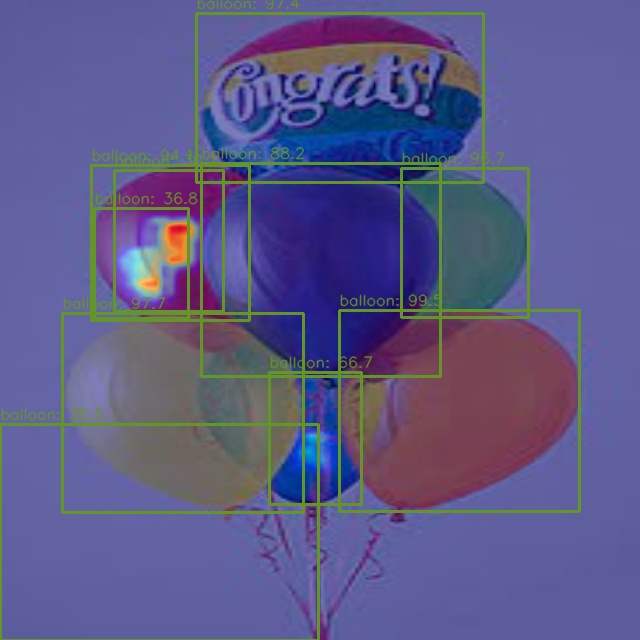

In [18]:
!python ../mmyolo/demo/boxam_vis_demo.py \
      resized_image.jpg \
      rtmdet_tiny_1xb12-40e_cat.py \
      work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco_bbox_mAP_epoch_40.pth  \
      --target-layer neck.out_convs[0]
Image.open('output/resized_image.jpg')  

可以发现由于大物体不会在该层预测，因此梯度可视化是 0，符合预期。